In [1]:
# set up
%load_ext autoreload
%autoreload 2
%pip install numpy matplotlib scipy shapely

import numpy as np
import logging
from typing import List, Dict, Tuple, Optional

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
plt.rcParams['animation.embed_limit'] = 2**128
from simulator import CrowdSimulator, Agent, SocialForceModel, create_test_scenario
from LeaderFollowerSFM import Leader_Follower_SFM
from mpc_controller import MPCLocalPlanner,RobotMPCController
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

Note: you may need to restart the kernel to use updated packages.


Back to default planner   distance: 8.00
In LF_SFM, leader is:  None Chosen
self.sim.leader_ID=['None Chosen']
goal: [np.int64(0), np.int64(5)]
WE FOUND A LEADER:  1
self.leader=1
In LF_SFM, leader is:  1
self.sim.leader_ID=['None Chosen', 1]
goal: [np.float64(-0.7673394725505902), np.float64(-2.7103432297955865)]
WE FOUND A LEADER:  1
self.leader=1
In LF_SFM, leader is:  1
self.sim.leader_ID=['None Chosen', 1, 1]
goal: [np.float64(-0.8451857389415126), np.float64(-2.5770407715257657)]
WE FOUND A LEADER:  1
self.leader=1
In LF_SFM, leader is:  1
self.sim.leader_ID=['None Chosen', 1, 1, 1]
goal: [np.float64(-0.9081159734448059), np.float64(-2.438837163560466)]
WE FOUND A LEADER:  1
self.leader=1
In LF_SFM, leader is:  1
self.sim.leader_ID=['None Chosen', 1, 1, 1, 1]
goal: [np.float64(-0.9858167928380829), np.float64(-2.3232708709984027)]
WE FOUND A LEADER:  1
self.leader=1
---catching up---
In LF_SFM, leader is:  1
self.sim.leader_ID=['None Chosen', 1, 1, 1, 1, 1]
goal: [np.float64(-1.0

2025-12-07 14:14:12,376 - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


THIS IS FRAME:  0
149
THIS IS FRAME:  0
149
THIS IS FRAME:  0
149
THIS IS FRAME:  0
149
THIS IS FRAME:  1
149
THIS IS FRAME:  2
149
THIS IS FRAME:  3
149
THIS IS FRAME:  4
149
THIS IS FRAME:  5
149
THIS IS FRAME:  6
149
THIS IS FRAME:  7
149
THIS IS FRAME:  8
149
THIS IS FRAME:  9
149
THIS IS FRAME:  10
149
THIS IS FRAME:  11
149
THIS IS FRAME:  12
149
THIS IS FRAME:  13
149
THIS IS FRAME:  14
149
THIS IS FRAME:  15
149
THIS IS FRAME:  16
149
THIS IS FRAME:  17
149
THIS IS FRAME:  18
149
THIS IS FRAME:  19
149
THIS IS FRAME:  20
149
THIS IS FRAME:  21
149
THIS IS FRAME:  22
149
THIS IS FRAME:  23
149
THIS IS FRAME:  24
149
THIS IS FRAME:  25
149
THIS IS FRAME:  26
149
THIS IS FRAME:  27
149
THIS IS FRAME:  28
149
THIS IS FRAME:  29
149
THIS IS FRAME:  30
149
THIS IS FRAME:  31
149
THIS IS FRAME:  32
149
THIS IS FRAME:  33
149
THIS IS FRAME:  34
149
THIS IS FRAME:  35
149
THIS IS FRAME:  36
149
THIS IS FRAME:  37
149
THIS IS FRAME:  38
149
THIS IS FRAME:  39
149
THIS IS FRAME:  40
149
T

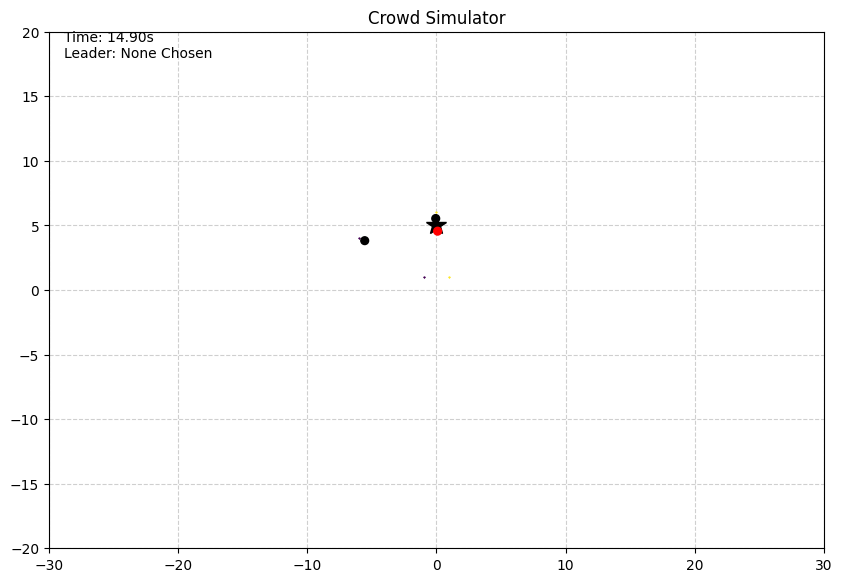

In [2]:
# TODO Implemement the above function and run the below simulation to check if the robot is able to reach the goal.
sim = CrowdSimulator(time_step=0.1, max_steps=300)
robot = sim.add_robot(x=0, y=-3, gx=[0], gy=[5], v_pref=1.0)
human1 = sim.add_human(x=-.5, y=-2, gx=[-1, -6], gy=[1, 4], v_pref=1.0)
human2 = sim.add_human(x=2, y=6, gx=[1, 0], gy=[1, 6], v_pref=1.0)
sim.set_human_policy(human1.id, SocialForceModel()) 
sim.set_human_policy(human2.id, SocialForceModel())
# mpc_policy = RobotMPCController(
#     horizon=8,
#     dt=sim.time_step,
#     max_speed=1.0,
#     wg=1.0
# )
sim.set_robot_policy(Leader_Follower_SFM(sim=sim)) # sebastian, we should add a preferred velocity for the robot's SFM, it needs to change (self.v0 changes) based on the human its following

for step in range(sim.max_steps):
    _, _, done, _ = sim.step()
    if done:
        break

sim.visualize_simulation(show_plot=True)

Back to default planner   distance: 7.81
In LF_SFM, leader is:  None Chosen
self.sim.leader_ID=['None Chosen']
goal: [np.int64(-7), np.int64(1)]
WE FOUND A LEADER:  17
self.leader=17
---catching up---
In LF_SFM, leader is:  17
self.sim.leader_ID=['None Chosen', 17]
goal: [np.float64(-13.60138587086937), np.float64(-4.8597640543284335)]
WE FOUND A LEADER:  18
self.leader=18
---catching up---
In LF_SFM, leader is:  18
self.sim.leader_ID=['None Chosen', 17, 18]
goal: [np.float64(-1.4135398278278144), np.float64(4.007003233541045)]
WE FOUND A LEADER:  15
self.leader=15
---catching up---
In LF_SFM, leader is:  15
self.sim.leader_ID=['None Chosen', 17, 18, 15]
goal: [np.float64(-2.9910386601322654), np.float64(16.703239629917448)]
WE FOUND A LEADER:  17
self.leader=17
##### Push further ######
before getting scale
after gettting scale:  1.0275596081955418
---catching up---
In LF_SFM, leader is:  17
self.sim.leader_ID=['None Chosen', 17, 18, 15, 17]
goal: [np.float64(-13.295233964002927), np.

2025-12-10 15:16:09,585 - INFO - Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
2025-12-10 15:16:09,586 - INFO - MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 1000x1000 -pix_fmt rgba -framerate 12 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y Roundabout.mp4


THIS IS FRAME:  0
202
THIS IS FRAME:  0
202
Saving animation to Roundabout.mp4...
THIS IS FRAME:  0
202
THIS IS FRAME:  0
202
THIS IS FRAME:  1
202
THIS IS FRAME:  2
202
THIS IS FRAME:  3
202
THIS IS FRAME:  4
202
THIS IS FRAME:  5
202
THIS IS FRAME:  6
202
THIS IS FRAME:  7
202
THIS IS FRAME:  8
202
THIS IS FRAME:  9
202
THIS IS FRAME:  10
202
THIS IS FRAME:  11
202
THIS IS FRAME:  12
202
THIS IS FRAME:  13
202
THIS IS FRAME:  14
202
THIS IS FRAME:  15
202
THIS IS FRAME:  16
202
THIS IS FRAME:  17
202
THIS IS FRAME:  18
202
THIS IS FRAME:  19
202
THIS IS FRAME:  20
202
THIS IS FRAME:  21
202
THIS IS FRAME:  22
202
THIS IS FRAME:  23
202
THIS IS FRAME:  24
202
THIS IS FRAME:  25
202
THIS IS FRAME:  26
202
THIS IS FRAME:  27
202
THIS IS FRAME:  28
202
THIS IS FRAME:  29
202
THIS IS FRAME:  30
202
THIS IS FRAME:  31
202
THIS IS FRAME:  32
202
THIS IS FRAME:  33
202
THIS IS FRAME:  34
202
THIS IS FRAME:  35
202
THIS IS FRAME:  36
202
THIS IS FRAME:  37
202
THIS IS FRAME:  38
202
THIS IS F

2025-12-10 15:16:35,402 - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


Save complete.
THIS IS FRAME:  0
202
THIS IS FRAME:  0
202
THIS IS FRAME:  1
202
THIS IS FRAME:  2
202
THIS IS FRAME:  3
202
THIS IS FRAME:  4
202
THIS IS FRAME:  5
202
THIS IS FRAME:  6
202
THIS IS FRAME:  7
202
THIS IS FRAME:  8
202
THIS IS FRAME:  9
202
THIS IS FRAME:  10
202
THIS IS FRAME:  11
202
THIS IS FRAME:  12
202
THIS IS FRAME:  13
202
THIS IS FRAME:  14
202
THIS IS FRAME:  15
202
THIS IS FRAME:  16
202
THIS IS FRAME:  17
202
THIS IS FRAME:  18
202
THIS IS FRAME:  19
202
THIS IS FRAME:  20
202
THIS IS FRAME:  21
202
THIS IS FRAME:  22
202
THIS IS FRAME:  23
202
THIS IS FRAME:  24
202
THIS IS FRAME:  25
202
THIS IS FRAME:  26
202
THIS IS FRAME:  27
202
THIS IS FRAME:  28
202
THIS IS FRAME:  29
202
THIS IS FRAME:  30
202
THIS IS FRAME:  31
202
THIS IS FRAME:  32
202
THIS IS FRAME:  33
202
THIS IS FRAME:  34
202
THIS IS FRAME:  35
202
THIS IS FRAME:  36
202
THIS IS FRAME:  37
202
THIS IS FRAME:  38
202
THIS IS FRAME:  39
202
THIS IS FRAME:  40
202
THIS IS FRAME:  41
202
THIS IS

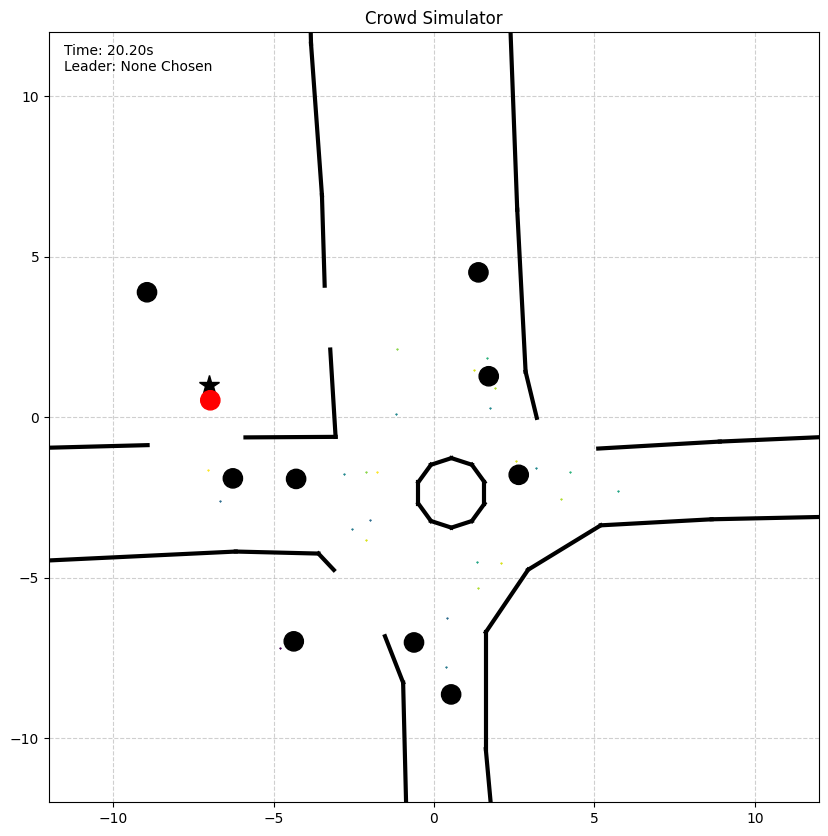

In [3]:
import math
# TODO Implemement the above function and run the below simulation to check if the robot is able to reach the goal.
sim = CrowdSimulator(time_step=0.1, max_steps=250)

# Object: Circle
sim.add_obstacle((-0.0933, -1.4797),(0.5437, -1.2727))
sim.add_obstacle((-0.4870, -2.0216),(-0.0933, -1.4797))
sim.add_obstacle((-0.4870, -2.6914),(-0.4870, -2.0216))
sim.add_obstacle((-0.0933, -3.2333),(-0.4870, -2.6914))
sim.add_obstacle((0.5437, -3.4403),(-0.0933, -3.2333))
sim.add_obstacle((1.1808, -3.2333),(0.5437, -3.4403))
sim.add_obstacle((1.5745, -2.6914),(1.1808, -3.2333))
sim.add_obstacle((1.5745, -2.0216),(1.5745, -2.6914))
sim.add_obstacle((1.1808, -1.4797),(1.5745, -2.0216))
sim.add_obstacle((0.5437, -1.2727),(1.1808, -1.4797))

# Object: Vert
sim.add_obstacle((-12.4277, -0.9596),(-8.9258, -0.8683))
sim.add_obstacle((-5.8752, -0.6270),(-3.0665, -0.6101))
sim.add_obstacle((-3.4068, 4.1014),(-3.4919, 6.9208))
sim.add_obstacle((-3.4919, 6.9208),(-3.8323, 11.6436))
sim.add_obstacle((-3.8323, 11.6436),(-4.0502, 20.1405))
sim.add_obstacle((-3.0665, -0.6101),(-3.2324, 2.1117))
sim.add_obstacle((13.8719, -0.5396),(8.9082, -0.7573))
sim.add_obstacle((8.9082, -0.7573),(5.1201, -0.9750))
sim.add_obstacle((3.2043, -0.0171),(2.8560, 1.4197))
sim.add_obstacle((2.8560, 1.4197),(2.5947, 6.4705))
sim.add_obstacle((2.5947, 6.4705),(2.2160, 16.5458))
sim.add_obstacle((2.2160, 16.5458),(2.4277, 21.5276))
sim.add_obstacle((14.5633, -3.0537),(8.6551, -3.1794))
sim.add_obstacle((8.6551, -3.1794),(5.1982, -3.3680))
sim.add_obstacle((5.1982, -3.3680),(2.9355, -4.7508))
sim.add_obstacle((2.9355, -4.7508),(1.6155, -6.6992))
sim.add_obstacle((1.6155, -6.6992),(1.6155, -10.3447))
sim.add_obstacle((1.6155, -10.3447),(2.1812, -16.5672))
sim.add_obstacle((-12.7778, -4.4994),(-6.1783, -4.1851))
sim.add_obstacle((-6.1783, -4.1851),(-3.6013, -4.2480))
sim.add_obstacle((-1.5271, -6.8249),(-0.9614, -8.2706))
sim.add_obstacle((-0.9614, -8.2706),(-0.7729, -15.9386))
sim.add_obstacle((-0.7729, -15.9386),(-0.6472, -19.0813))
sim.add_obstacle((-3.6013, -4.2480),(-3.1211, -4.7582))

# add robot -----------------------------------------
robot = sim.add_robot(x=-1, y=-4, gx=[-7], gy=[1], v_pref=1.5)

human_0 = sim.add_human(x=2.0452, y=-2.5968, gx=[-4.8118], gy=[-7.1761], v_pref=1.2)
sim.set_human_policy(human_0.id, SocialForceModel())
human_1 = sim.add_human(x=2.1401, y=-3.0713, gx=[-17.3998], gy=[-14.5671], v_pref=1.2)
sim.set_human_policy(human_1.id, SocialForceModel())
human_2 = sim.add_human(x=1.7842, y=-3.5933, gx=[-17.9294], gy=[-13.7867], v_pref=1.2)
sim.set_human_policy(human_2.id, SocialForceModel())
human_3 = sim.add_human(x=0.6554, y=-4.1432, gx=[-20.2448], gy=[-15.8706], v_pref=1.2)
sim.set_human_policy(human_3.id, SocialForceModel())
human_4 = sim.add_human(x=0.5107, y=-3.8248, gx=[-20.3895], gy=[-15.5522], v_pref=1.2)
sim.set_human_policy(human_4.id, SocialForceModel())
human_5 = sim.add_human(x=-0.2707, y=-4.6063, gx=[-21.1710], gy=[-16.3336], v_pref=1.2)
sim.set_human_policy(human_5.id, SocialForceModel())
human_6 = sim.add_human(x=-14.2465, y=-2.8127, gx=[-6.6777, -1.9831, 0.4121, 0.8912], gy=[-2.6211, -3.1959, -6.2618, -15.2677], v_pref=3.1)
sim.set_human_policy(human_6.id, SocialForceModel())
human_7 = sim.add_human(x=-9.4561, y=-2.9564, gx=[-2.5579, 0.3642, 0.1247], gy=[-3.4834, -7.7947, -15.4114], v_pref=1.5)
sim.set_human_policy(human_7.id, SocialForceModel())
human_8 = sim.add_human(x=8.2684, y=-1.5672, gx=[3.1905, 1.7534, -1.1687, -2.7974, -16.3543], gy=[-1.5672, 0.3010, 0.1094, -1.7588, -1.4714], v_pref=2.4)
sim.set_human_policy(human_8.id, SocialForceModel())
human_9 = sim.add_human(x=4.1007, y=-2.9564, gx=[14.9749], gy=[-2.2858], v_pref=2)
sim.set_human_policy(human_9.id, SocialForceModel())
human_10 = sim.add_human(x=-2.8210, y=-2.6746, gx=[1.3281, 5.7467, 18.1401], gy=[-4.5067, -2.2974, -2.0819], v_pref=1.5)
sim.set_human_policy(human_10.id, SocialForceModel())
human_11 = sim.add_human(x=15.0148, y=-1.2197, gx=[4.2379, 1.6514, 0.7354], gy=[-1.7047, 1.8517, 16.8316], v_pref=1.8)
sim.set_human_policy(human_11.id, SocialForceModel())
human_12 = sim.add_human(x=1.2742, y=-10.5957, gx=[1.7592], gy=[-16.7386], v_pref=2)
sim.set_human_policy(human_12.id, SocialForceModel())
human_13 = sim.add_human(x=0.6355, y=2.8565, gx=[-0.2665], gy=[18.0101], v_pref=3.1)
sim.set_human_policy(human_13.id, SocialForceModel())
human_14 = sim.add_human(x=-2.2440, y=16.8632, gx=[-1.1616, -2.1237, -20.5245], gy=[2.1305, -1.7180, -1.5376], v_pref=2.5)
sim.set_human_policy(human_14.id, SocialForceModel())
human_15 = sim.add_human(x=1.4843, y=-15.4284, gx=[1.3640, 3.9498, 1.9053, 1.0634], gy=[-5.3260, -2.5599, 0.9279, 17.8253], v_pref=1.75)
sim.set_human_policy(human_15.id, SocialForceModel())
human_16 = sim.add_human(x=-13.9098, y=-4.1233, gx=[-2.1237, 2.0856, 2.5667, 1.2438, 0.1012], gy=[-3.8227, -4.5443, -1.3572, 1.4691, 17.6449], v_pref=1.8)
sim.set_human_policy(human_16.id, SocialForceModel())
human_17 = sim.add_human(x=-0.6204, y=4.1751, gx=[-1.7629, -7.0546, -13.3085], gy=[-1.7180, -1.6579, 16.4423], v_pref=1.2)
sim.set_human_policy(human_17.id, SocialForceModel())


sim.set_robot_policy(Leader_Follower_SFM(sim=sim))

for step in range(sim.max_steps):
    _, _, done, _ = sim.step()
    if done:
        break

sim.visualize_simulation(show_plot=True, output_file="Roundabout.mp4")